# Laboratorio 1 - Machine learning techniques

### Daniel Giraldo - 201328110
### Iván García - 201614488

### Aclaracion previa
Las etapas de Comprensión y Preparación de los datos se realizó de la misma manera que era expuesto en el laboratorio, dado que se disponian de los mismos datos. 


In [1]:
"""
Imports 
"""
import pandas as pd
from pandas_profiling import ProfileReport

from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler, PolynomialFeatures 
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsRegressor


import matplotlib.pyplot as plt

import numpy as np

visualization = True

C:\Users\ivang\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
"""
Download data set 
"""
url = 'https://raw.githubusercontent.com/jcestevezc/Machine-Learning-Techniques/master/Laboratorio%201/kc_house_data.csv'
data = pd.read_csv(url)
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


# Comprensión de los datos
### **Definición de las variables:**
id: a notation for a house.  
date: Date house was sold.  
price: Price is prediction target.  
bedrooms: Number of Bedrooms/House.  
bathrooms: Number of bathrooms/House.  
sqft_living: square footage of the home.  
sqft_lotsquare: footage of the lot.  
floors: Total floors (levels) in house.  
waterfront: House which has a view to a waterfront.  
view: Has been viewed.  
condition: How good the condition is ( Overall ).  
gradeoverall: grade given to the housing unit, based on King County grading system.  
sqft_above: square footage of house apart from basement.  
sqft_basement: square footage of the basement.  
yr_built: Built Year.  
yr_renovated: Year when house was renovated.  
zipcode: zip.  
lat: Latitude coordinate.  
long: Longitude coordinate.  
sqft_living15: Living room area in 2015(implies-- some renovations) This might or might not have affected the lotsize area.
sqft_lot15: lotSize area in 2015(implies-- some renovations).

In [3]:
ProfileReport(data)


## Diagnostico 

1. df_index: es una columna única para la que todas las filas son distintas, por dicha razón, es pertinente quitarla de los datos.  

2. date: es una columna con alta cardinalidad y que no tiene incidencia en el precio según la lógica del negocio expuesta, no es pertinente incluir.  

3. sqft_above: es la variables con mayor correlación con sqft_living por eso se decide quitarla.  

4. zip_code: es una variable con muchos datos faltantes (zeros) los cuales estan al rededor de 95%.  

## Matriz de correlación:

In [15]:
corr = data.corr()
corr.style.background_gradient(cmap='coolwarm')



,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,0.016112,0.016809,0.030791,0.016382,-0.130414,0.033106,-0.000732,0.018651,-0.027126,0.039244,0.020644,-0.006304,0.028587,-0.018527,-0.008468,0.004159,0.022497,0.016115,-0.143442
price,0.016112,1.000000,0.283695,0.432910,0.602722,0.080260,0.265424,0.050261,0.226948,0.041719,0.615919,0.505005,0.214728,0.050901,0.083039,-0.012836,0.441827,0.062273,0.543070,0.067973
bedrooms,0.016809,0.283695,1.000000,0.486298,0.601301,0.016842,0.160748,-0.035627,0.024187,0.025500,0.339833,0.479349,0.257153,0.192110,-0.006388,-0.169706,-0.047784,0.162784,0.397576,0.014838
bathrooms,0.030791,0.432910,0.486298,1.000000,0.701521,0.047190,0.508182,-0.007508,0.080976,-0.135130,0.609258,0.619411,0.194432,0.560055,0.020926,-0.212921,-0.013332,0.249477,0.518266,0.045420
sqft_living,0.016382,0.602722,0.601301,0.701521,1.000000,0.136534,0.338227,0.000184,0.149115,-0.069638,0.695680,0.844805,0.344100,0.363457,0.018814,-0.211683,0.006963,0.288480,0.734185,0.151021
sqft_lot,-0.130414,0.080260,0.016842,0.047190,0.136534,1.000000,-0.025247,0.025526,0.077844,-0.002216,0.075292,0.145946,-0.006717,0.036998,0.012418,-0.126980,-0.096461,0.216414,0.133003,0.691957
floors,0.033106,0.265424,0.160748,0.508182,0.338227,-0.025247,1.000000,-0.003855,-0.018634,-0.277441,0.457961,0.530709,-0.313487,0.516337,-0.007722,-0.065087,0.035398,0.131970,0.260378,-0.031962
waterfront,-0.000732,0.050261,-0.035627,-0.007508,0.000184,0.025526,-0.003855,1.000000,0.300025,0.016370,-0.013820,-0.008466,0.015193,-0.039174,0.053649,0.041279,-0.046125,-0.059011,0.004033,0.034292
view,0.018651,0.226948,0.024187,0.080976,0.149115,0.077844,-0.018634,0.300025,1.000000,0.036052,0.118048,0.049990,0.184644,-0.071918,0.060646,0.102506,-0.025906,-0.080621,0.174683,0.075389
condition,-0.027126,0.041719,0.025500,-0.135130,-0.069638,-0.002216,-0.277441,0.016370,0.036052,1.000000,-0.170747,-0.179285,0.187408,-0.353337,-0.058801,-0.006370,-0.018260,-0.098911,-0.116333,0.003240


## Datos atípicos:

In [16]:
data = data[np.abs(data.price - data.price.mean()) <= ( 3 * data.price.std())]
data = data[~(np.abs(data.price - data.price.mean()) > (3 * data.price.std()))]

data = data[np.abs(data.bedrooms - data.bedrooms.mean()) <= ( 3 * data.bedrooms.std())]
data = data[~(np.abs(data.bedrooms - data.bedrooms.mean()) > (3 * data.bedrooms.std()))]

data = data[np.abs(data.sqft_living - data.sqft_living.mean()) <= ( 3 * data.sqft_living.std())]
data = data[~(np.abs(data.sqft_living - data.sqft_living.mean()) > (3 * data.sqft_living.std()))]




In [17]:


"""
Selección de variables
"""
X = data.drop(['id','date','zipcode','sqft_above','price'],axis=1)
y = data['price']

In [18]:
"""
Normalización
"""
columns = X.columns
scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(X)
X = pd.DataFrame(X,columns=columns)
X.head()


,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15
0,0.50,0.210526,0.220109,0.003108,0.0,0.0,0.0,0.5,0.444444,0.000,0.478261,0.000000,0.571498,0.217608,0.206768,0.008927
1,0.50,0.473684,0.597826,0.004072,0.4,0.0,0.0,0.5,0.444444,0.200,0.443478,0.988089,0.908959,0.166113,0.283674,0.012479
2,0.25,0.210526,0.108696,0.005743,0.0,0.0,0.0,0.5,0.333333,0.000,0.286957,0.000000,0.936143,0.237542,0.509998,0.013235
3,0.75,0.631579,0.432065,0.002714,0.0,0.0,0.0,1.0,0.444444,0.455,0.565217,0.000000,0.586939,0.104651,0.211162,0.007767
4,0.50,0.421053,0.355978,0.004579,0.0,0.0,0.0,0.5,0.555556,0.000,0.756522,0.000000,0.741354,0.393688,0.307844,0.012236


In [19]:
"""
Separar datos test y train
"""
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=33)


In [20]:
"""
Linear regression
"""
LinearModel = LinearRegression().fit(X_train, y_train)
print ('Intercept: ',LinearModel.intercept_)
list(zip(X_train, LinearModel.coef_))



Intercept:  -238530.8676215192


[('bedrooms', -47253.06914007371),
 ('bathrooms', 121182.71056657546),
 ('sqft_living', 278759.83319166274),
 ('sqft_lot', 390477.5108507251),
 ('floors', 72966.49372307124),
 ('waterfront', 108706.86734625528),
 ('view', 112307.24823622662),
 ('condition', 111051.84479565102),
 ('grade', 641205.9190536814),
 ('sqft_basement', -6535.470363147819),
 ('yr_built', -196268.40310719106),
 ('yr_renovated', 23454.498506145457),
 ('lat', 325840.48214877496),
 ('long', -14246.160694874307),
 ('sqft_living15', 212024.1667891604),
 ('sqft_lot15', -69189.06526716832)]

In [21]:
"""
Polynomial regression
"""
pf = PolynomialFeatures(degree = 2,interaction_only=True)    # usaremos polinomios de grado 2
X_pol = pf.fit_transform(X)  # transformamos la entrada en polinómica

print('shape X: ', X_pol.shape)
X_train_pol, X_test_pol, y_train, y_test = train_test_split(X_pol, y, test_size=0.2, random_state=33)

print('shape X_train: ', X_train_pol.shape)
print('shape y_train: ', y_train.shape)
PolyModel = LinearRegression().fit(X_train_pol, y_train)
print ('Intercept: ',PolyModel.intercept_)
list(zip(pf.get_feature_names(X_train.columns), PolyModel.coef_))



shape X:  (19815, 137)
shape X_train:  (15852, 137)
shape y_train:  (15852,)
Intercept:  79651.30977926188


[('1', -9.42284766420942e-12),
 ('bedrooms', -63896.986720199886),
 ('bathrooms', -236917.6162313074),
 ('sqft_living', 91175.39268824614),
 ('sqft_lot', 349114.26365955116),
 ('floors', 49328.76011996652),
 ('waterfront', 748367.0581050925),
 ('view', 158012.6410380807),
 ('condition', -45350.705781309836),
 ('grade', 101904.44422395047),
 ('sqft_basement', 118120.7856941895),
 ('yr_built', 25902.886976697802),
 ('yr_renovated', 19557.72175096893),
 ('lat', 160834.32083134574),
 ('long', -238726.77681784722),
 ('sqft_living15', -10371.923247813625),
 ('sqft_lot15', 43799.25434687533),
 ('bedrooms bathrooms', 56073.9725408759),
 ('bedrooms sqft_living', -170183.8504793867),
 ('bedrooms sqft_lot', 220935.40171624892),
 ('bedrooms floors', 135513.29134868307),
 ('bedrooms waterfront', 128888.43049817864),
 ('bedrooms view', -38221.64313046186),
 ('bedrooms condition', -61631.53229397883),
 ('bedrooms grade', 175559.27835404602),
 ('bedrooms sqft_basement', 36595.53345226544),
 ('bedrooms

In [22]:
"""
Predicción lineal
"""
y_prediction_lineal = LinearModel.predict(X_test)
y_prediction_lineal


array([305303.99809537, 445616.57005815, 449289.45200208, ...,
       551514.9776747 , 493323.28067487, 274506.21110624])

In [23]:
"""
Predicción polinomial
"""
y_prediction_poly = PolyModel.predict(X_test_pol)
y_prediction_poly


array([316326.39013632, 445292.23361997, 420646.65932902, ...,
       571084.94500414, 434255.15916815, 265118.97374759])

In [27]:
"""
Validación
"""
print('------------ Regresión Lineal ------------')
print("Mean absolute error: %.2f" % np.mean(np.absolute(y_prediction_lineal - y_test)))
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_prediction_lineal , y_test))
print("R2-score: %.2f" % r2_score(y_prediction_lineal , y_test) )
print('\n')
print('---------- Regresión Polinomial ----------')
print("Mean absolute error: %.2f" % np.mean(np.absolute(y_prediction_poly - y_test)))
print("Residual sum of squares (MSE): %.2f" % mean_squared_error(y_prediction_poly , y_test))
print("R2-score: %.2f" % r2_score(y_prediction_poly , y_test) )


------------ Regresión Lineal ------------
Mean absolute error: 86381.94
Residual sum of squares (MSE): 12840526280.85
R2-score: 0.51


---------- Regresión Polinomial ----------
Mean absolute error: 79286.41
Residual sum of squares (MSE): 11371847098.66
R2-score: 0.59


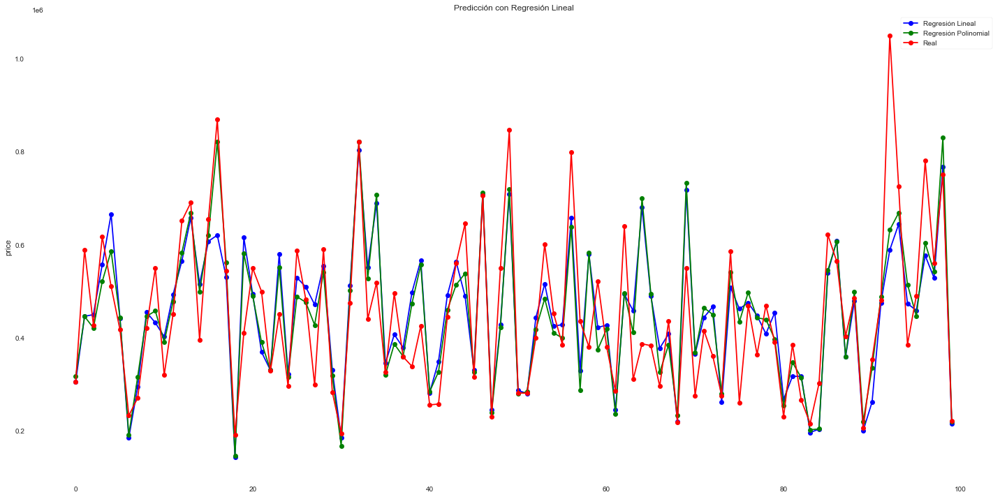

In [28]:
if visualization:
    fig = plt.figure(figsize=(20,10))

    ax = fig.add_subplot(111)
    xvals = list(range(len(y_test[:100])))
    ax.plot(xvals, y_prediction_lineal[:100],'bo-', label='Regresión Lineal')
    ax.plot(xvals, y_prediction_poly[:100],'go-', label='Regresión Polinomial')
    ax.plot(xvals, y_test[:100],'ro-', label='Real')

    ax.set(title='Predicción con Regresión Lineal',ylabel=y.name)
    ax.legend()

    plt.tight_layout()
    plt.show()

# Taller
#### 1. Construir una tabla que muestre los valores de las medidas de rendimiento con grados de polinomio 2, 3, 4, 10 y 20 ¿Qué puede concluir?




In [29]:
"""
Train
"""
degrees = [2, 3, 4]
X_train_pol = []
X_test_pol = []
y_train = []
y_test = []
num_variables = []
PolyModel = []

for i, deg in enumerate(degrees):
    pf = PolynomialFeatures(degree=deg, interaction_only=True) # Grado del polinomio
    X_pol = pf.fit_transform(X)

    print('Degree {} X dimensions: {}\n\n'.format(deg, X_pol.shape))
    
    _X_train_pol, _X_test_pol, _y_train, _y_test = train_test_split(X_pol, y, test_size=0.2, random_state=33)
    
    X_train_pol.append(_X_train_pol)
    X_test_pol.append(_X_test_pol)
    y_train.append(_y_train)
    y_test.append(_y_test)
    num_variables.append(X_pol.shape[1])

    _PolyModel = LinearRegression().fit(X_train_pol[i], y_train[i])
    PolyModel.append(_PolyModel)



Degree 2 X dimensions: (19815, 137)


Degree 3 X dimensions: (19815, 697)


Degree 4 X dimensions: (19815, 2517)




In [30]:
"""
Predicción
"""
y_prediction_poly = []
y_train_poly = []

for i, deg in enumerate(degrees):
    print('{} degree Y prediction: '.format(deg))
    predictions = PolyModel[i].predict(X_test_pol[i])
    print(predictions[:10])
    y_prediction_poly.append(predictions)

    y_train_poly.append(PolyModel[i].predict(X_train_pol[i]))


2 degree Y prediction: 
[316326.39013632 445292.23361997 420646.65932902 520634.99581648
 586099.67242727 442797.2673224  190409.62889387 314908.61940026
 445673.15689052 457194.26955136]
3 degree Y prediction: 
[317622.42776352 462122.11134453 423748.15026397 466424.76917339
 697470.48056539 434654.27044506 197348.29028856 327857.66250293
 417508.82473882 475814.86332582]
4 degree Y prediction: 
[ 310323.29168368  484821.54691866  442738.82090933 1157712.69132032
  504474.76471153  402026.04944942  190598.93828486  315401.13649911
  399816.04511195  494778.43998423]


In [33]:
"""
Validación
"""

# Validación
print('--- Validation results ---')

results = {
    'Degree': [],
    'Mean absolute error': [],
    'Residual sum of squares': [],
    'R2-score': [],
    'Num variables': []
}

for i, deg in enumerate(degrees):
    results['Mean absolute error'].append(np.mean(np.absolute(y_prediction_poly[i] - y_test[i])))
    results['Residual sum of squares'].append(mean_squared_error(y_prediction_poly[i] , y_test[i]))
    results['R2-score'].append(r2_score(y_prediction_poly[i] , y_test[i]))
    results['Num variables'].append(num_variables[i])
    results['Degree'].append(deg)


df = pd.DataFrame(results)
print(df)

# Train
print('\n\n--- Training results ---')
results = {
    'Degree': [],
    'Mean absolute error': [],
    'Residual sum of squares': [],
    'R2-score': [],
    'Num variables': []
}

for i, deg in enumerate(degrees):
    results['Mean absolute error'].append(np.mean(np.absolute(y_train_poly[i] - y_train[i])))
    results['Residual sum of squares'].append(mean_squared_error(y_train_poly[i] , y_train[i]))
    results['R2-score'].append(r2_score(y_train_poly[i] , y_train[i]))
    results['Num variables'].append(num_variables[i])
    results['Degree'].append(deg)

df = pd.DataFrame(results)
print(df)

--- Validation results ---
   Degree  Mean absolute error  Residual sum of squares  R2-score  \
0       2         79286.406866             1.137185e+10  0.588788   
1       3         78434.768623             1.236817e+10  0.583926   
2       4        142956.202846             1.414748e+12  0.014653   

   Num variables  
0            137  
1            697  
2           2517  


--- Training results ---
   Degree  Mean absolute error  Residual sum of squares  R2-score  \
0       2         77584.965450             1.083742e+10  0.618284   
1       3         72662.831165             9.723811e+09  0.670435   
2       4         65090.414319             8.016679e+09  0.743155   

   Num variables  
0            137  
1            697  
2           2517  


#### Analisis:
- Concluir que entre más grados de libertad más overfit se tiene y peor es la generalización. El número de variables que el algoritmo puede ajustar crece exponencialmente con el grado del polinomio por lo que con grados más altos puede lograr un ajuste casi perfecto con los datos de prueba en vez de generalizar. Esto se evidencia en como cuando incrementa el grado del polinomio mejoran los resultados de entrenamiento pero empeoran los de validación.Para el polinomio de grado 4 se tenían 2517 variables que es muy alto comparado con los 20255 datos de prueba, esto se ve evidenciado en el error que tambien crece exponencialmente. No se pudo validar con grados más altos por los recursos que toman pero se espera que este comportamiento empeore aún más con grados 10 o 20.

#### 2. Resuelva el mismo problema con el algoritmo K-NN para regresión, y muestre los valores de rendimiento sobre entrenamiento y test utilizando los valores de K = 1, 2, 3, 5, 10, 20 y 30. ¿Qué puede concluir?


In [34]:
"""
KNN Train
"""
nbrs = [1, 2, 3, 4, 5, 10, 20, 30]
KNN = []

X_train_knn, X_test_knn, y_train_knn, y_test_knn = train_test_split(X, y, test_size=0.2, random_state=33)

for i, nbr in enumerate(nbrs):
    KNN.append(KNeighborsRegressor(n_neighbors=nbr).fit(X_train_knn, y_train_knn))



In [35]:
"""
KNN Predict
"""
y_prediction_knn = []
train_predictions_knn = []

for i, nbr in enumerate(nbrs):
    predictions = KNN[i].predict(X_test_knn)
    print(predictions[:10])
    y_prediction_knn.append(predictions)

    train_predictions_knn.append(KNN[i].predict(X_train_knn))



[269000. 414900. 385000. 679000. 715000. 435000. 250000. 255000. 340000.
 462608.]
[275350.  482450.  433750.  634500.  687500.  496500.  237500.  285000.
 385600.  424599.5]
[241900.         467941.33333333 429166.66666667 589333.33333333
 700000.         495333.33333333 231666.66666667 316666.66666667
 404733.33333333 407392.        ]
[264675.   460956.   408875.   563750.   661250.   491500.   202500.
 329500.   412150.   408935.25]
[263940.  460764.8 466700.  619000.  672000.  475600.  206000.  323599.8
 407720.  411146.2]
[260105.  540252.4 442400.  616550.  714100.  476340.  233650.  299124.9
 408440.  460523.1]
[257675.   540439.95 413950.   612175.   645702.4  449270.   226075.
 324063.6  406682.5  487538.  ]
[266350.         549493.3        427116.5        615333.33333333
 654234.93333333 486086.66666667 227131.66666667 316009.06666667
 420921.66666667 520818.66666667]


--- Training results ---
   Num neighbors  Mean absolute error  Residual sum of squares  R2-score
0              1           893.234166             1.708438e+08  0.995643
1              2         41047.296366             3.551599e+09  0.898373
2              3         48315.480612             4.811275e+09  0.855072
3              4         51808.798779             5.441122e+09  0.830163
4              5         53980.661090             5.866261e+09  0.812480
5             10         59283.529618             7.059009e+09  0.755919
6             20         63920.026886             8.048552e+09  0.703917
7             30         66217.727435             8.578067e+09  0.671852


--- Validation results ---
   Num neighbors  Mean absolute error  Residual sum of squares  R2-score
0              1         82496.840273             1.413723e+10  0.621465
1              2         73142.595004             1.097539e+10  0.672410
2              3         70200.500463             1.016559e+10  0.6785

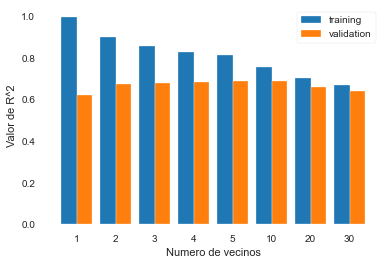

In [47]:
"""
KNN Validate
"""

# Training
print('--- Training results ---')
results_training = {
    'Num neighbors': [],
    'Mean absolute error': [],
    'Residual sum of squares': [],
    'R2-score': []
}

for i, nbr in enumerate(nbrs):
    results_training['Mean absolute error'].append(np.mean(np.absolute(train_predictions_knn[i] - y_train_knn)))
    results_training['Residual sum of squares'].append(mean_squared_error(train_predictions_knn[i], y_train_knn))
    results_training['R2-score'].append(r2_score(train_predictions_knn[i], y_train_knn))
    results_training['Num neighbors'].append(nbr)

df = pd.DataFrame(results_training)
print(df)

results_validation = {
    'Num neighbors': [],
    'Mean absolute error': [],
    'Residual sum of squares': [],
    'R2-score': []
}

# Validation
print('\n\n--- Validation results ---')
for i, nbr in enumerate(nbrs):
    results_validation['Mean absolute error'].append(np.mean(np.absolute(y_prediction_knn[i] - y_test_knn)))
    results_validation['Residual sum of squares'].append(mean_squared_error(y_prediction_knn[i], y_test_knn))
    results_validation['R2-score'].append(r2_score(y_prediction_knn[i], y_test_knn))
    results_validation['Num neighbors'].append(nbr)

df = pd.DataFrame(results)
print(df)

#Grafica con resultados
import matplotlib.pyplot as plt
xpos = np.arange(len(results_training['R2-score']))
plt.xticks(xpos, nbrs)
plt.xlabel("Numero de vecinos")
plt.ylabel("Valor de R^2")
plt.bar(xpos - 0.2, results_training['R2-score'], width = 0.4, label="training")
plt.bar(xpos + 0.2, results_validation['R2-score'], width = 0.4, label="validation")
plt.legend()





### Análisis y conclusiones.
- Entre más vecinos se tenga menos va a ser el overfit que tenga el modelo, hasta el punto que el modelo va a ser tan simple que va a empezar a hacer underfitting con los datos entregados. Por lo que se espera que entre 5 y 10 vecinos el modelo tenga un rendimiento mayor al mismo tiempo en los datos de entrenamiento y de validación. 

- De los dos modelos, el modelo que parece tener un mejor rendimiento es el de KNN, ya que entrega los valores de R^2 mejor ajustados. No obstante, esto puede deberse a la integridad de los datos y es sesgo que pueda generarse cuando se realiza la regresión lineal con estos. 

- Un análisis previo de reducción de la dimensionalidad del problema podría ser pertinente dado que ayudaría a reducir "ruido" como los datos atípicos o variables correlacionadas y podríamos encontrar mejores resultados en ambos modelos.

- Algunos problemas que también pueden influir en los malos resultados del modelo de regresión son problemas no estudiados como la heteroscedasticidad en el término del error de cada estimación de Y cuando se corre el modelo o la autocorrelación a un nivel específico entre las variables. 